###***Required Packages***

In [1]:
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()
import cv2
import numpy as np
import os
import shutil
import glob
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

Instructions for updating:
non-resource variables are not supported in the long term


###***Models***

In [2]:
!wget https://raw.githubusercontent.com/khurramjaved96/Recursive-CNNs/server_branch/TrainedModel/cornerRefiner.pb
!wget https://raw.githubusercontent.com/khurramjaved96/Recursive-CNNs/server_branch/TrainedModel/getCorners.pb

--2020-09-26 15:37:36--  https://raw.githubusercontent.com/khurramjaved96/Recursive-CNNs/server_branch/TrainedModel/cornerRefiner.pb
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 403699 (394K) [application/octet-stream]
Saving to: ‘cornerRefiner.pb’

cornerRefiner.pb    100%[===================>] 394.24K  --.-KB/s    in 0.07s   

2020-09-26 15:37:36 (5.79 MB/s) - ‘cornerRefiner.pb’ saved [403699/403699]

--2020-09-26 15:37:37--  https://raw.githubusercontent.com/khurramjaved96/Recursive-CNNs/server_branch/TrainedModel/getCorners.pb
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request 

###***Operational Functions***

In [3]:
def load_graph(frozen_graph_filename, inputName, outputName):
    # We load the protobuf file from the disk and parse it to retrieve the
    # unserialized graph_def
    with tf.gfile.GFile(frozen_graph_filename, "rb") as f:
        graph_def = tf.GraphDef()
        graph_def.ParseFromString(f.read())
    # Then, we can use again a convenient built-in function to import a graph_def into the
    # current default Graph
    with tf.Graph().as_default() as graph:
        tf.import_graph_def(
            graph_def,
            input_map=None,
            return_elements=None,
            name="prefix",
            op_dict=None,
            producer_op_list=None
        )
    x = graph.get_tensor_by_name('prefix/'+inputName+':0')
    y = graph.get_tensor_by_name('prefix/'+outputName+':0')
    return graph, x, y


def refineCorner(img, sess, x,y_eval, retainFactor):
    ans_x = 0.0
    ans_y = 0.0
    o_img = np.copy(img)
    y = None
    x_start = 0
    y_start = 0
    up_scale_factor = (img.shape[1], img.shape[0])
    myImage = np.copy(o_img)
    CROP_FRAC = retainFactor
    while(myImage.shape[0]>10 and myImage.shape[1]>10):
        img_temp = cv2.resize(myImage, (32, 32))
        img_temp = np.expand_dims(img_temp, axis=0)
        response = y_eval.eval(feed_dict={
            x: img_temp}, session=sess)
        response_up = response[0]
        response_up = response_up * up_scale_factor
        y = response_up + (x_start, y_start)
        x_loc = int(y[0])
        y_loc = int(y[1])

        if x_loc > myImage.shape[1] / 2:
            start_x = min(x_loc + int(round(myImage.shape[1] * CROP_FRAC / 2)), myImage.shape[1]) - int(round(
                myImage.shape[1] * CROP_FRAC))
        else:
            start_x = max(x_loc - int(myImage.shape[1] * CROP_FRAC / 2), 0)
        if y_loc > myImage.shape[0] / 2:
            start_y = min(y_loc + int(myImage.shape[0] * CROP_FRAC / 2), myImage.shape[0]) - int(
                myImage.shape[0] * CROP_FRAC)
        else:
            start_y = max(y_loc - int(myImage.shape[0] * CROP_FRAC / 2), 0)
        ans_x += start_x
        ans_y += start_y
        myImage = myImage[start_y:start_y + int(myImage.shape[0] * CROP_FRAC),
                  start_x:start_x + int(myImage.shape[1] * CROP_FRAC)]
        img = img[start_y:start_y + int(img.shape[0] * CROP_FRAC), start_x:start_x + int(img.shape[1] * CROP_FRAC)]
        up_scale_factor = (img.shape[1], img.shape[0])

    ans_x += y[0]
    ans_y += y[1]
    return (int(round(ans_x)), int(round(ans_y)))

def getCorners(img, sess, x, output):
        o_img = np.copy(img)
        myImage = np.copy(o_img)
        img_temp = cv2.resize(myImage, (32, 32))
        img_temp = np.expand_dims(img_temp, axis=0)
        response = output.eval(feed_dict={
            x: img_temp}, session=sess)
        response = response[0]
        x = response[[0, 2, 4, 6]]
        y = response[[1, 3, 5, 7]]
        x = x*myImage.shape[1]
        y = y*myImage.shape[0]

        tl = myImage[max(0, int(2*y[0] - (y[3]+y[0])/2)):int((y[3]+y[0])/2),
            max(0, int(2*x[0] - (x[1]+x[0])/2)):int((x[1]+x[0])/2)]

        tr = myImage[max(0, int(2*y[1] - (y[1]+y[2])/2)):int((y[1]+y[2])/2),
            int((x[1]+x[0])/2):min(myImage.shape[1]-1, int(x[1]+(x[1]-x[0])/2))]

        br = myImage[int((y[1]+y[2])/2):min(myImage.shape[0]-1, int(y[2]+(y[2]-y[1])/2)),
              int((x[2]+x[3])/2):min(myImage.shape[1]-1, int(x[2]+(x[2]-x[3])/2))]

        bl = myImage[int((y[0]+y[3])/2):min(myImage.shape[0]-1, int(y[3]+(y[3]-y[0])/2)),
             max(0, int(2*x[3] - (x[2]+x[3])/2)):int((x[3]+x[2])/2)]

        tl = (tl, max(0, int(2*x[0] -(x[1]+x[0])/2)), max(0, int(2*y[0] - (y[3]+y[0])/2)))
        tr = (tr, int((x[1]+x[0])/2), max(0, int(2*y[1] - (y[1]+y[2])/2)))
        br = (br, int((x[2]+x[3])/2), int((y[1]+y[2])/2))
        bl = (bl, max(0, int(2*x[3] - (x[2]+x[3])/2)), int((y[0]+y[3])/2))
        return tl, tr, br, bl

def order_points(pts):
        # initialzie a list of coordinates that will be ordered
        # such that the first entry in the list is the top-left,
        # the second entry is the top-right, the third is the
        # bottom-right, and the fourth is the bottom-left
        rect = np.zeros((4, 2), dtype = "float32")
        # the top-left point will have the smallest sum, whereas
        # the bottom-right point will have the largest sum
        s = pts.sum(axis = 1)
        rect[0] = pts[np.argmin(s)]
        rect[2] = pts[np.argmax(s)]
        # now, compute the difference between the points, the
        # top-right point will have the smallest difference,
        # whereas the bottom-left will have the largest difference
        diff = np.diff(pts, axis = 1)
        rect[1] = pts[np.argmin(diff)]
        rect[3] = pts[np.argmax(diff)]
        # return the ordered coordinates
        return rect

def four_point_transform(image, pts):
        # obtain a consistent order of the points and unpack them
        # individually
        rect = order_points(pts)
        (tl, tr, br, bl) = rect
        # compute the width of the new image, which will be the
        # maximum distance between bottom-right and bottom-left
        # x-coordiates or the top-right and top-left x-coordinates
        widthA = np.sqrt(((br[0] - bl[0]) ** 2) + ((br[1] - bl[1]) ** 2))
        widthB = np.sqrt(((tr[0] - tl[0]) ** 2) + ((tr[1] - tl[1]) ** 2))
        maxWidth = max(int(widthA), int(widthB))
        # compute the height of the new image, which will be the
        # maximum distance between the top-right and bottom-right
        # y-coordinates or the top-left and bottom-left y-coordinates
        heightA = np.sqrt(((tr[0] - br[0]) ** 2) + ((tr[1] - br[1]) ** 2))
        heightB = np.sqrt(((tl[0] - bl[0]) ** 2) + ((tl[1] - bl[1]) ** 2))
        maxHeight = max(int(heightA), int(heightB))
        # now that we have the dimensions of the new image, construct
        # the set of destination points to obtain a "birds eye view",
        # (i.e. top-down view) of the image, again specifying points
        # in the top-left, top-right, bottom-right, and bottom-left
        # order
        dst = np.array([
                [0, 0],
                [maxWidth - 1, 0],
                [maxWidth - 1, maxHeight - 1],
                [0, maxHeight - 1]], dtype = "float32")
        # compute the perspective transform matrix and then apply it
        M = cv2.getPerspectiveTransform(rect, dst)
        warped = cv2.warpPerspective(image, M, (maxWidth, maxHeight))
        # return 
        return warped

def add_bg(im):
    h,w = im.shape[:2]
    bg = 100*np.ones((2*h,2*w,3),dtype='uint8')
    h_start , w_start  = int(h/2), int(w/2)
    bg[h_start: h+h_start , w_start: w+w_start] = im
    return bg




###***Folder creation***

In [4]:
if not (os.path.exists('input_img')):
  os.mkdir('input_img')
if not (os.path.exists('output_img')):
  os.mkdir('output_img')

###***Upload your images by clicking on the button and later choose your images***

In [5]:
%cd input_img/
from google.colab import files
uploaded = files.upload()
%cd ../

/content/input_img


Saving img1.jpg to img1.jpg
/content


###***Output Result***

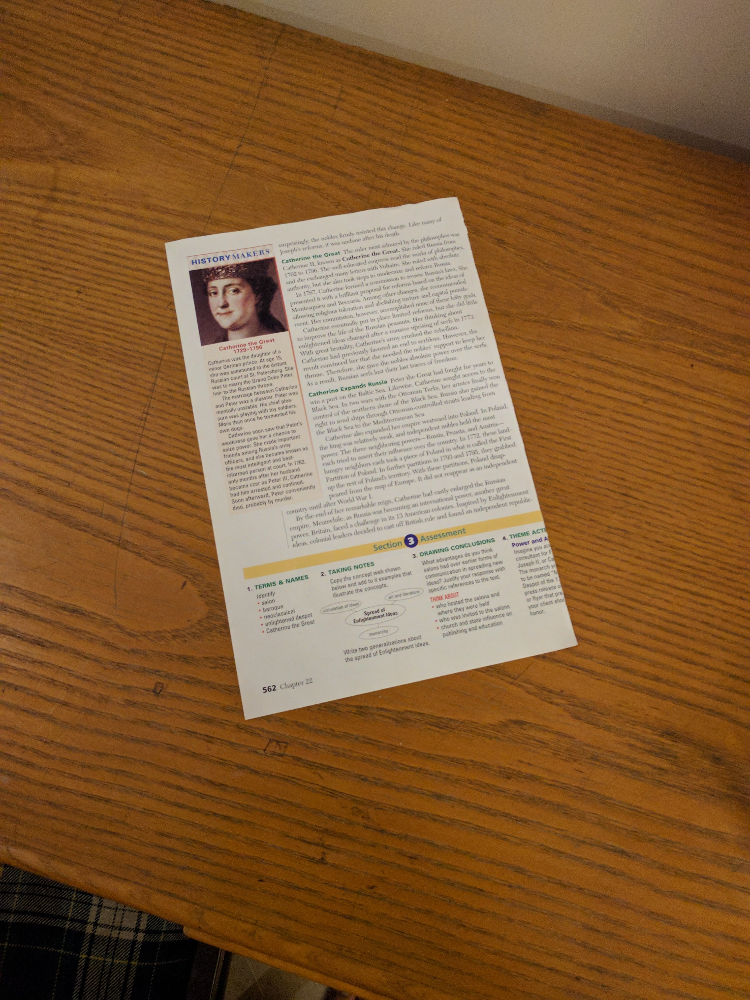

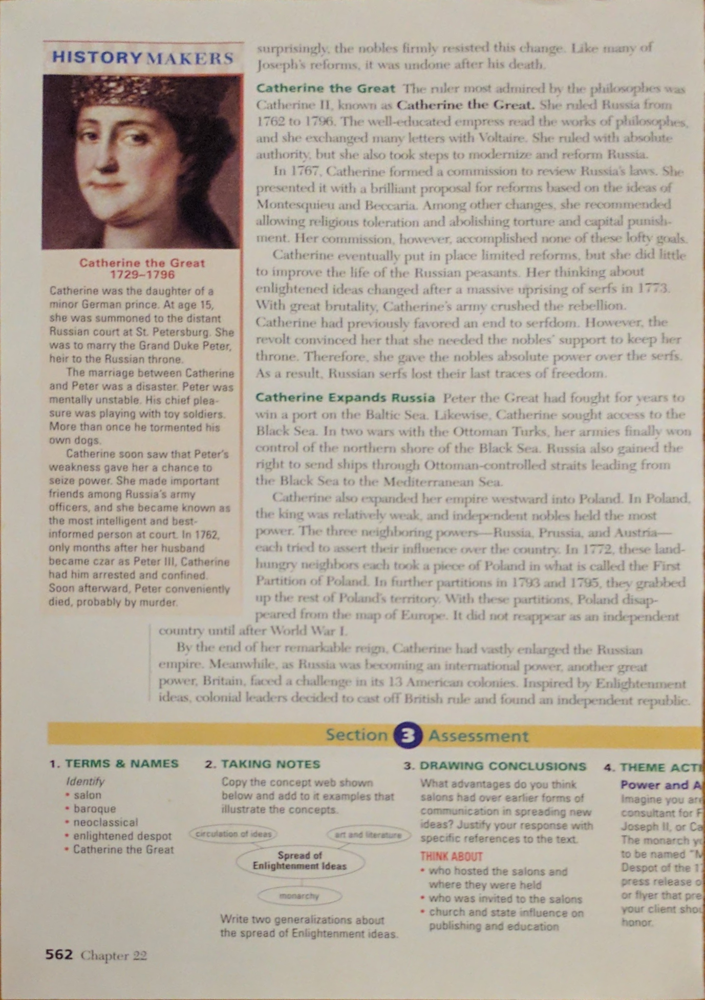

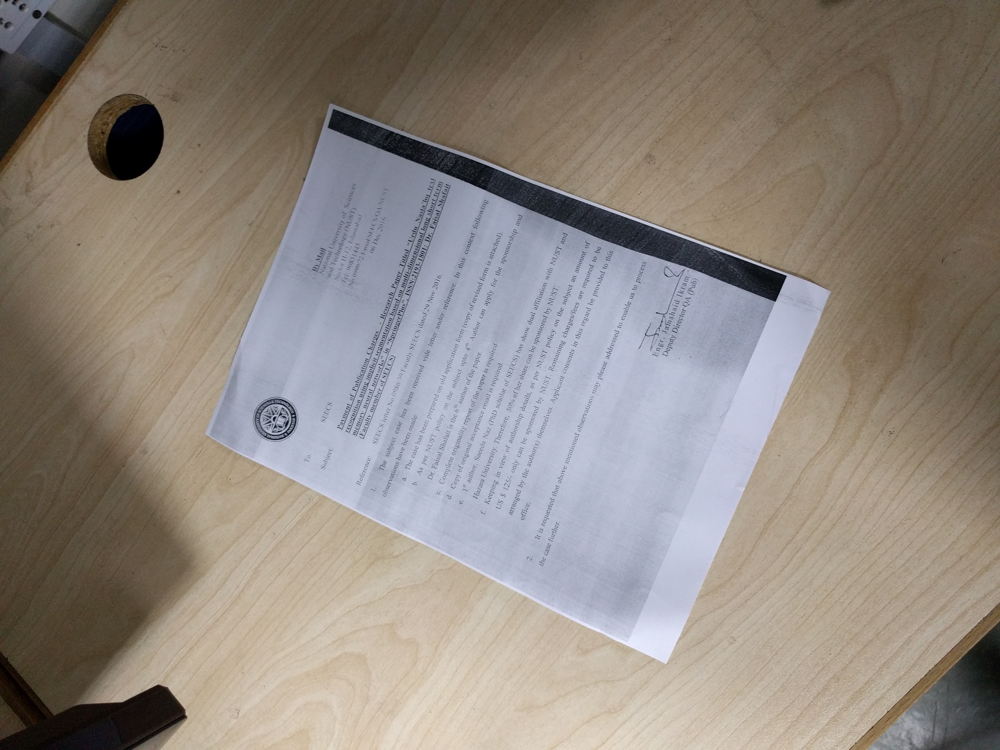

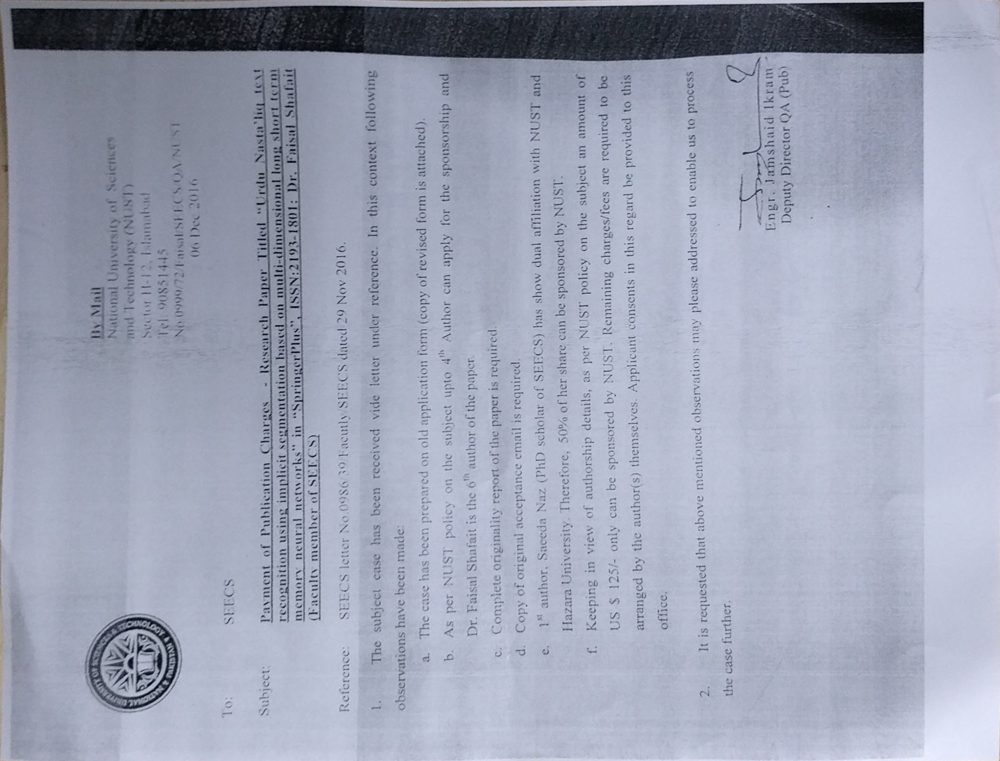

In [13]:
graph, x, y = load_graph('cornerRefiner.pb', "Corner/inputTensor", "Corner/outputTensor")
graphCorners, xCorners, yCorners = load_graph('getCorners.pb', "Input/inputTensor", "FCLayers/outputTensor")

all_imgs = glob.glob('input_img/*')

for imagePath in all_imgs:     
  sess = tf.Session(graph=graph)
  sessCorners = tf.Session(graph=graphCorners)
  img = cv2.imread(imagePath)
  output= img.copy()
  # img = shadow_removal(img)
  data = getCorners(img, sessCorners, xCorners, yCorners)
  corner_address = []
  counter = 0
  for b in data:
    a = b[0]
    temp = np.array(refineCorner(a, sess, x, y, float(0.85)))
    temp[0] += b[1]
    temp[1] += b[2]
    corner_address.append(temp)
    # print(temp)
    counter += 1

  for a in range(0, len(data)):
    cv2.line(img, tuple(corner_address[a % 4]), tuple(corner_address[(a + 1) % 4]), (255, 0, 0), 4)
    warped = four_point_transform(output, np.array(corner_address))
  cv2_imshow(output)
  cv2.imwrite(os.path.join('output_img',imagePath[imagePath.rindex('/')+1:-4]+'_transformed.png'),output)
  cv2.imwrite(os.path.join('output_img', imagePath[imagePath.rindex('/')+1:-4]+'_warped.png'), warped)
  cv2_imshow(warped)

In [9]:
!zip -r /content/file.zip /content/output_img


  adding: content/output_img/ (stored 0%)
  adding: content/output_img/.ipynb_checkpoints/ (stored 0%)
  adding: content/output_img/img_transformed.png (deflated 5%)
  adding: content/output_img/img2_transformed.png (deflated 16%)
  adding: content/output_img/img_warped.png (deflated 1%)
  adding: content/output_img/img2_warped.png (deflated 14%)


In [12]:
from google.colab import files
files.download("/content/file.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>